In [1]:
# from keras.models import Model, load_model
from keras.layers import Dense, Flatten, Input
from keras.layers import Conv2D, MaxPool2D
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint

import seaborn as sn
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
import glob as gb
from tqdm import tqdm
import pandas as pd
from skimage.io import imread
import tensorflow as tf
from PIL import Image,ExifTags
            
from keras import backend as K
import segmentation_models as sm

#Scikitlearn
from sklearn.preprocessing import OneHotEncoder
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import jaccard_score
from sklearn.metrics import confusion_matrix,f1_score

print("tensorflow version : ",tf.__version__)

# import my library Code 

import sys
sys.path.append('../')
from mylib import mylib as ml
from mylib import mymetric as mt
# from mylib import manage_data as md
# from mylib import Exp_model as exp
# md.check()

#Segmentation model
sm.set_framework('tf.keras')
sm.framework()
from sklearn.model_selection import train_test_split

2024-03-12 14:31:31.221996: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


Segmentation Models: using `keras` framework.
tensorflow version :  2.9.1


In [5]:
import tensorflow as tf
physical_devices = tf.config.list_physical_devices('GPU')
print(physical_devices)
try:
    os.environ["CUDA_VISIBLE_DEVICES"]="0"
    for gpu in range(len(physical_devices)):
        tf.config.experimental.set_memory_growth(physical_devices[gpu], True)
        tf.config.set_logical_device_configuration(
        physical_devices[gpu],
        [tf.config.LogicalDeviceConfiguration(memory_limit=512*4)])
    print("Success")
except Exception as e:
  # Invalid device or cannot modify virtual devices once initialized.
    print("GOT EXCEPTION",e)    
    pass

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')]
Success


In [6]:
#Full size image
data_type = "Full images"
img_path = "../Dataset/trainning2/images"
gt_path = "../Dataset/trainning2/labels"

#Crop mouth Images
# data_type = "Crop Mouth images"
# img_path = "../Dataset/trainning3(crop mouth)/images"
# gt_path = "../Dataset/trainning3(crop mouth)/labels"


images_dir = gb.glob(img_path+"/*")
labels_dir = gb.glob(gt_path+"/*")
images_dir.sort()
labels_dir.sort()
images_dir
print("Image has 8 dataset")
print(len(images_dir),len(labels_dir))

Image has 8 dataset
8 8


In [7]:
#Load list of images each class
images_lst = []
for i in images_dir:
    fname_lst = gb.glob(i+"/*")
    fname_lst.sort()
    images_lst.append(fname_lst)
images_lst.sort()
    
labels_lst = []
for i in labels_dir:
    fname_lst = gb.glob(i+"/*")
    fname_lst.sort()
    labels_lst.append(fname_lst)
labels_lst.sort()
print(len(images_lst),len(labels_lst))
for i in range(len(images_lst)):
    print(len(images_lst[i]),len(labels_lst[i]))

8 8
147 147
139 139
82 82
125 125
79 79
199 199
91 91
93 93


In [8]:
data = {}

In [9]:
# data["ModelName"] = "segment_oral_multi_oragan_padding_6"
# data["ModelName"] = "segment_oral_multi_oragan_stretch_crop_mouth_1"
data["ModelName"] = "segment_oral_multi_oragan_n2_30"
data["ModelACTT"] = "FPN"         
data["BackBone"] = "efficientnetb5" #efficientnetb5#mobilenetv2 efficientnetb5 resnet50
data["Class"] = 7+1
data["Epoch"] = 300
data["BatchSize"] = 8
data["Optimizer"] = "Adam"
data["LearningRate"] = 1e-3
data["min_lr"] = 1e-5
data["Beta1"] = 0.9
data["Beta2"] =  0.999
data["ImgSize"] = (512,512)
data['EarlyStop'] = 50
data['Detail'] = "Model FPN efficientnetb5 "
# data['Detail'] = "Focal Tverksy alpha = 0.5 Bete = 0.5 Gamma = 2.0"
#set Path to save all files
save_model_path = "../Oral_segment_result/"
if os.path.isdir(save_model_path+data["ModelName"]) == False:
    os.mkdir(save_model_path+data["ModelName"])
    ml.dict_2_txt(data,save_model_path+"data.txt") # save data detail
else:
    print("Already have this model name")
save_model_path = save_model_path+data["ModelName"]+"/"



Already have this model name


In [10]:
import random

data['randomstate_splitdata'] = 804
random.seed(data['randomstate_splitdata'])
# test_size = 0.2
# #10 percent 
# # 0.8*0.125 = 0.1 of 100
# valid_size = 0.125
# Xtrain_n,Ytrain_n,Xvalid_n,Yvalid_n,Xtest_n,Ytest_n = [],[],[],[],[],[] 
# for i in range(len(images_lst)):
#     xtn,xtt,ytn,ytt=train_test_split(images_lst[i],labels_lst[i],test_size=test_size,random_state=data['randomstate_splitdata'])
# #     print(xtn[0].split("/")[-1],ytn[0].split("/")[-1])
#     xtn,xvt,ytn,yvt=train_test_split(xtn,ytn,test_size=valid_size,random_state=data['randomstate_splitdata'])
#     Xtrain_n,Ytrain_n = Xtrain_n + xtn , Ytrain_n+ytn
#     Xvalid_n,Yvalid_n= Xvalid_n +xvt , Yvalid_n +yvt
#     Xtest_n,Ytest_n= Xtest_n +xtt , Ytest_n +ytt
    
# lst1 = list(zip(Xtrain_n,Ytrain_n))
# lst2 = list(zip(Xvalid_n,Yvalid_n))
# lst3 = list(zip(Xtest_n,Ytest_n))

# random.shuffle(lst1)
# random.shuffle(lst2)
# random.shuffle(lst3)
# Xtrain_n,Ytrain_n = zip(*lst1)
# Xvalid_n,Yvalid_n = zip(*lst2)
# Xtest_n,Ytest_n = zip(*lst3)
# Xtrain_n,Ytrain_n = list(Xtrain_n),list(Ytrain_n)
# Xvalid_n,Yvalid_n = list(Xvalid_n),list(Yvalid_n)
# Xtest_n,Ytest_n = list(Xtest_n),list(Ytest_n)

In [11]:
Xtrain_n,Ytrain_n,Xvalid_n,Yvalid_n,Xtest_n,Ytest_n = ml.Split_Dataset(images_lst,labels_lst,valid_size=0.1,test_size=0.2,seed=data['randomstate_splitdata'])
print(len(Xtrain_n),len(Ytrain_n),len(Xvalid_n),len(Yvalid_n),len(Xtest_n),len(Ytest_n))

valid_ratio 12.5 test_ratio 20.0
663 663 98 98 194 194


# Load Original Dataset

In [12]:
#Resize Normal form
Xtrain,Ytrain = [],[]
Xvalid, Yvalid = [] ,[]
Xtest,Ytest = [],[]

print("Load Train set")
for k,(m,n) in enumerate(zip(Xtrain_n,Ytrain_n)):
    print(" "*20,end="\r")
    print(k+1,"/",len(Xtrain_n),end="\r")
    im = cv2.imread(m)
    im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    im = cv2.resize(im,data['ImgSize'])
    lb = cv2.imread(n, 0) 
    lb = cv2.resize(lb,data['ImgSize'])
    Xtrain.append(im)
    Ytrain.append(lb)
print()
Xtrain = np.array(Xtrain)
Ytrain = np.array(Ytrain)
print(Xtrain.shape,Ytrain.shape)

print("Load validation set")
for k,(m,n) in enumerate(zip(Xvalid_n,Yvalid_n)):
    print(" "*20,end="\r")
    print(k+1,"/",len(Xvalid_n),end="\r")
    im = cv2.imread(m)
    im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    im = cv2.resize(im,data['ImgSize'])
    lb = cv2.imread(n, 0) 
    lb = cv2.resize(lb,data['ImgSize'])
    Xvalid.append(im)
    Yvalid.append(lb)
print()
Xvalid = np.array(Xvalid)
Yvalid = np.array(Yvalid)
print(Xvalid.shape,Yvalid.shape)


print("Load test set")
for k,(m,n) in enumerate(zip(Xtest_n,Ytest_n)):
    print(" "*20,end="\r")
    print(k+1,"/",len(Xtest_n),end="\r")
    im = cv2.imread(m)
    im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    im = cv2.resize(im,data['ImgSize'])
    lb = cv2.imread(n, 0) 
    lb = cv2.resize(lb,data['ImgSize'])
    Xtest.append(im)
    Ytest.append(lb)
print()
Xtest = np.array(Xtest)
Ytest = np.array(Ytest)
print(Xtest.shape,Ytest.shape)

Load Train set
663 / 663           
(663, 512, 512, 3) (663, 512, 512)
Load validation set
98 / 98             
(98, 512, 512, 3) (98, 512, 512)
Load test set
194 / 194           
(194, 512, 512, 3) (194, 512, 512)


In [10]:
# save_img_path = "./Resize diff method dataset/Stretch image/"
# for i,im in enumerate(Xtrain):
#     cv2.imwrite(save_img_path+"train/"+Xtrain_n[i].split("/")[-1],cv2.cvtColor(im, cv2.COLOR_RGB2BGR))
    
# for i,im in enumerate(Xvalid):
#     cv2.imwrite(save_img_path+"valid/"+Xvalid_n[i].split("/")[-1],cv2.cvtColor(im, cv2.COLOR_RGB2BGR))
    
# for i,im in enumerate(Xtest):
#     cv2.imwrite(save_img_path+"test/"+Xtest_n[i].split("/")[-1],cv2.cvtColor(im, cv2.COLOR_RGB2BGR))

In [11]:
# # #Resize Padding Zero
# Xtrain,Ytrain = [],[]
# Xvalid, Yvalid = [] ,[]
# Xtest,Ytest = [],[]

# print("Load Train set")
# for k,(m,n) in enumerate(zip(Xtrain_n,Ytrain_n)):
#     print(" "*20,end="\r")
#     print(k+1,"/",len(Xtrain_n),end="\r")
#     im = cv2.imread(m)
#     im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
#     im = tf.image.resize_with_pad(im,target_height=data['ImgSize'][1],target_width=data['ImgSize'][0], method='nearest')
#     im = im.numpy()
#     lb = cv2.imread(n, 0) 
#     lb = np.expand_dims(lb, axis=2)
#     lb = tf.image.resize_with_pad(lb,target_height=data['ImgSize'][1],target_width=data['ImgSize'][0], method='nearest')
#     lb = lb.numpy()
#     lb = np.squeeze(lb)
#     Xtrain.append(im)
#     Ytrain.append(lb)
# print()
# Xtrain = np.array(Xtrain)
# Ytrain = np.array(Ytrain)
# print(Xtrain.shape,Ytrain.shape)

# print("Load validation set")
# for k,(m,n) in enumerate(zip(Xvalid_n,Yvalid_n)):
#     print(" "*20,end="\r")
#     print(k+1,"/",len(Xvalid_n),end="\r")
#     im = cv2.imread(m)
#     im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
#     im = tf.image.resize_with_pad(im,target_height=data['ImgSize'][1],target_width=data['ImgSize'][0], method='nearest')
#     im = im.numpy()
#     lb = cv2.imread(n, 0) 
#     lb = np.expand_dims(lb, axis=2)
#     lb = tf.image.resize_with_pad(lb,target_height=data['ImgSize'][1],target_width=data['ImgSize'][0], method='nearest')
#     lb = lb.numpy()
#     lb = np.squeeze(lb)
#     Xvalid.append(im)
#     Yvalid.append(lb)
# print()
# Xvalid = np.array(Xvalid)
# Yvalid = np.array(Yvalid)
# print(Xvalid.shape,Yvalid.shape)


# print("Load test set")
# for k,(m,n) in enumerate(zip(Xtest_n,Ytest_n)):
#     print(" "*20,end="\r")
#     print(k+1,"/",len(Xtest_n),end="\r")
#     im = cv2.imread(m)
#     im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
#     im = tf.image.resize_with_pad(im,target_height=data['ImgSize'][1],target_width=data['ImgSize'][0], method='nearest')
#     im = im.numpy()
#     lb = cv2.imread(n, 0) 
#     lb = np.expand_dims(lb, axis=2)
#     lb = tf.image.resize_with_pad(lb,target_height=data['ImgSize'][1],target_width=data['ImgSize'][0], method='nearest')
#     lb = lb.numpy()
#     lb = np.squeeze(lb)
#     Xtest.append(im)
#     Ytest.append(lb)
# print()
# Xtest = np.array(Xtest)
# Ytest = np.array(Ytest)
# print(Xtest.shape,Ytest.shape)

In [12]:
# save_img_path = "./Resize diff method dataset/Padding zero/"
# for i,im in enumerate(Xtrain):
#     cv2.imwrite(save_img_path+"train/"+Xtrain_n[i].split("/")[-1],cv2.cvtColor(im, cv2.COLOR_RGB2BGR))
    
# for i,im in enumerate(Xvalid):
#     cv2.imwrite(save_img_path+"valid/"+Xvalid_n[i].split("/")[-1],cv2.cvtColor(im, cv2.COLOR_RGB2BGR))
    
# for i,im in enumerate(Xtest):
#     cv2.imwrite(save_img_path+"test/"+Xtest_n[i].split("/")[-1],cv2.cvtColor(im, cv2.COLOR_RGB2BGR))

In [13]:
# #Resize Reflec 
# import albumentations as A
# longestresize = A.Compose([
#     A.LongestMaxSize(max_size=512, interpolation=1, p=1)
#     # Add more augmentations if needed
# ])

# padifneed = A.Compose([
#     A.PadIfNeeded(min_height=512, min_width=512,border_mode=4),
#     # Add more augmentations if needed
# ])

# Xtrain,Ytrain = [],[]
# Xvalid, Yvalid = [] ,[]
# Xtest,Ytest = [],[]

# print("Load Train set")
# for k,(m,n) in enumerate(zip(Xtrain_n,Ytrain_n)):
#     print(" "*20,end="\r")
#     print(k+1,"/",len(Xtrain_n),end="\r")
#     im = cv2.imread(m)
#     im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
#     im = longestresize(image=im)
#     im = padifneed(image=im['image'])
#     im = im['image']
#     lb = cv2.imread(n, 0) 
#     lb = longestresize(image=lb)
#     lb = padifneed(image=lb['image'])
#     lb = lb['image']
#     Xtrain.append(im)
#     Ytrain.append(lb)
# print()
# Xtrain = np.array(Xtrain)
# Ytrain = np.array(Ytrain)
# print(Xtrain.shape,Ytrain.shape)

# print("Load validation set")
# for k,(m,n) in enumerate(zip(Xvalid_n,Yvalid_n)):
#     print(" "*20,end="\r")
#     print(k+1,"/",len(Xvalid_n),end="\r")
#     im = cv2.imread(m)
#     im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
#     im = longestresize(image=im)
#     im = padifneed(image=im['image'])
#     im = im['image']
#     lb = cv2.imread(n, 0) 
#     lb = longestresize(image=lb)
#     lb = padifneed(image=lb['image'])
#     lb = lb['image']
#     Xvalid.append(im)
#     Yvalid.append(lb)
# print()
# Xvalid = np.array(Xvalid)
# Yvalid = np.array(Yvalid)
# print(Xvalid.shape,Yvalid.shape)


# print("Load test set")
# for k,(m,n) in enumerate(zip(Xtest_n,Ytest_n)):
#     print(" "*20,end="\r")
#     print(k+1,"/",len(Xtest_n),end="\r")
#     im = cv2.imread(m)
#     im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
#     im = longestresize(image=im)
#     im = padifneed(image=im['image'])
#     im = im['image']
#     lb = cv2.imread(n, 0) 
#     lb = longestresize(image=lb)
#     lb = padifneed(image=lb['image'])
#     lb = lb['image']
#     Xtest.append(im)
#     Ytest.append(lb)
# print()
# Xtest = np.array(Xtest)
# Ytest = np.array(Ytest)
# print(Xtest.shape,Ytest.shape)

In [14]:
# save_img_path = "./Resize diff method dataset/Reflect/"
# for i,im in enumerate(Xtrain):
#     cv2.imwrite(save_img_path+"train/"+Xtrain_n[i].split("/")[-1],cv2.cvtColor(im, cv2.COLOR_RGB2BGR))
    
# for i,im in enumerate(Xvalid):
#     cv2.imwrite(save_img_path+"valid/"+Xvalid_n[i].split("/")[-1],cv2.cvtColor(im, cv2.COLOR_RGB2BGR))
    
# for i,im in enumerate(Xtest):
#     cv2.imwrite(save_img_path+"test/"+Xtest_n[i].split("/")[-1],cv2.cvtColor(im, cv2.COLOR_RGB2BGR))

/tmp/ipykernel_3132226/296553993.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  _,axs = plt.subplots(1,2,figsize=(10,10))


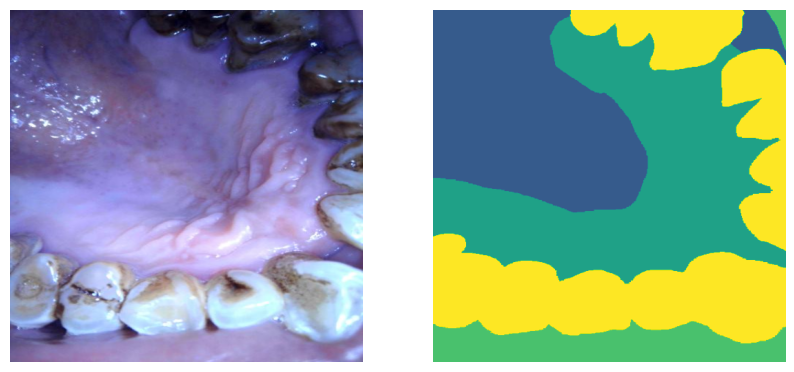

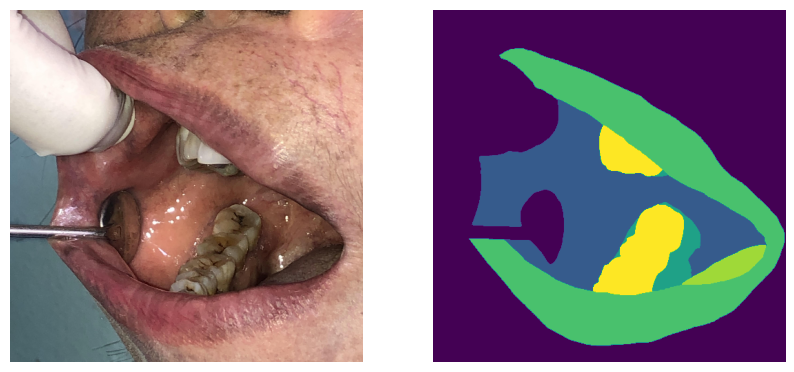

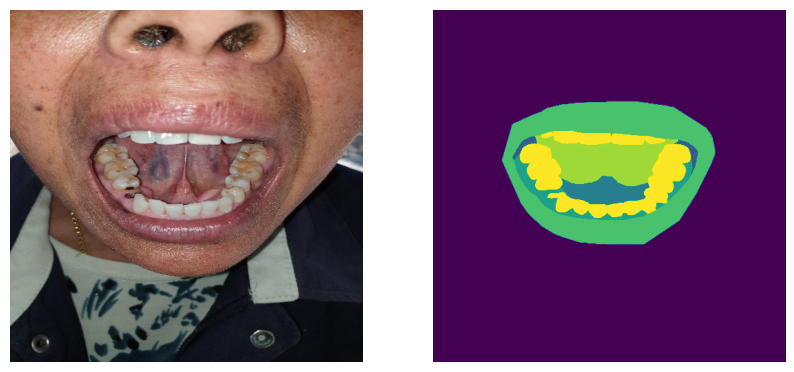

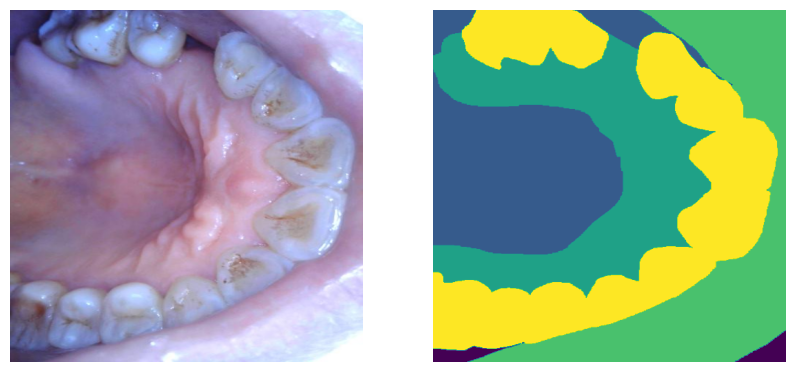

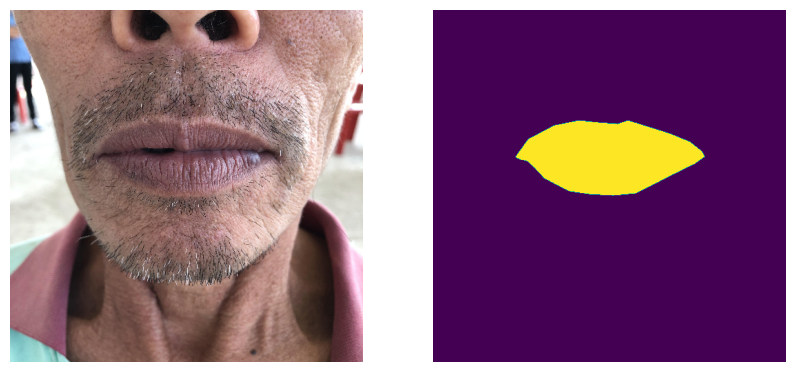

...

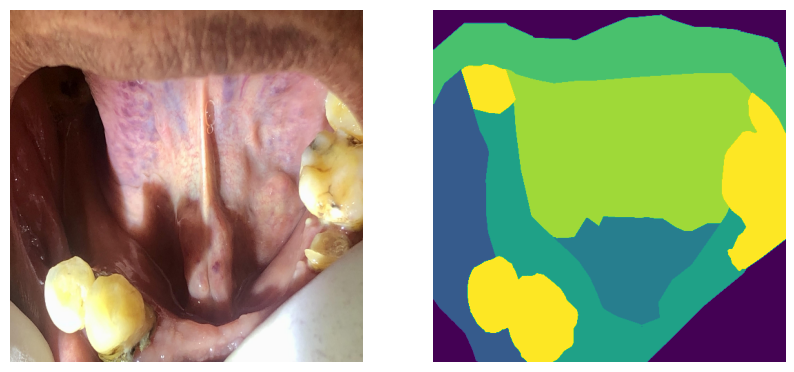

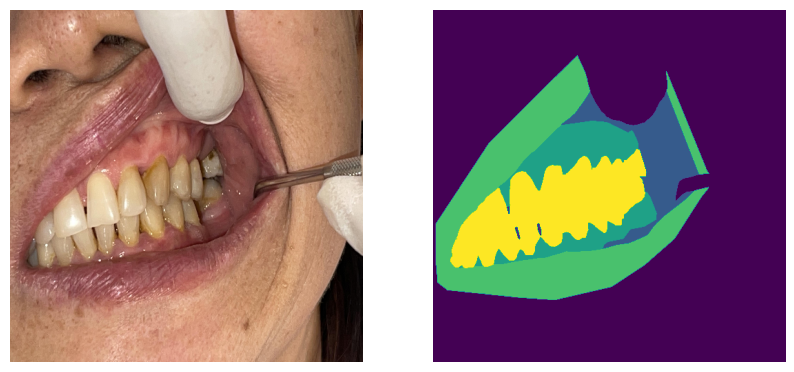

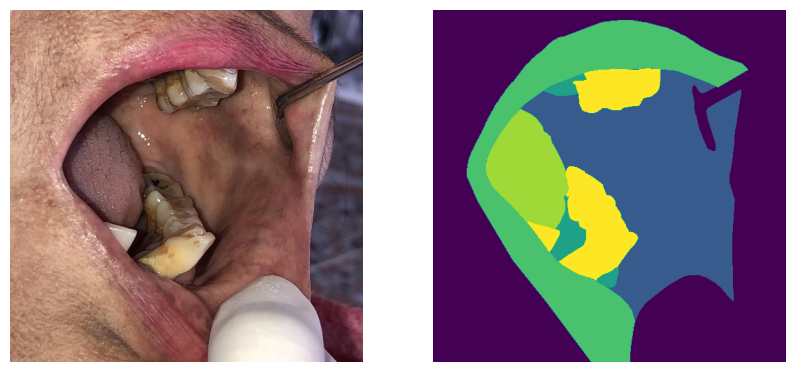

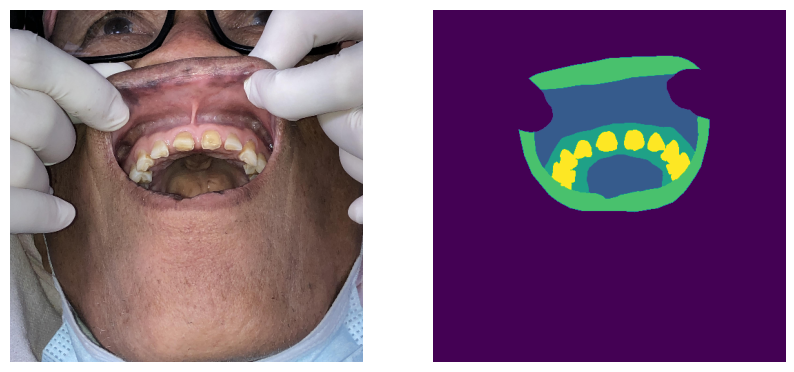

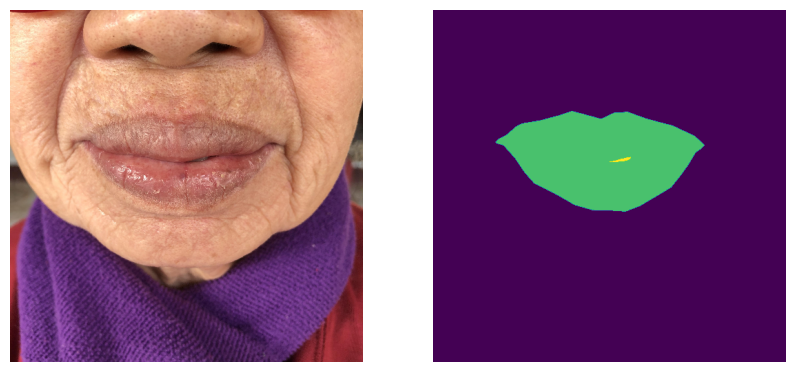

In [13]:
#Show images all
st,nn = 20,60
for x,y in zip(Xvalid[st:nn],Yvalid[st:nn]):
    _,axs = plt.subplots(1,2,figsize=(10,10))
    axs[0].imshow(x)
    axs[0].axis("off")
    axs[1].imshow(y)
    axs[1].axis("off")

In [14]:
Ytrain = to_categorical(Ytrain,num_classes=np.max(Ytrain)+1)
Yvalid = to_categorical(Yvalid,num_classes=np.max(Yvalid)+1)
Ytest = to_categorical(Ytest,num_classes=np.max(Ytest)+1)

In [15]:
Xtrain = Xtrain.astype(np.float32)
print("Done")
Xvalid = Xvalid.astype(np.float32)
print("Done")
Xtest = Xtest.astype(np.float32)
print("Done")
Ytrain = Ytrain.astype(np.float32)
print("Done")
Yvalid = Yvalid.astype(np.float32)
print("Done")
Ytest = Ytest.astype(np.float32)
print("Done")

Done
Done
Done
Done
Done
Done


In [ ]:
data["TrainSize"],data["ValidSize"],data["TestSize"] = len(Xtrain),len(Xvalid),len(Xtest)
ml.dict_2_txt(data,save_model_path+"data.txt") # save data detail

In [ ]:

'''Segmentation models '''
if data['BackBone'] != 'no':
    print("BB include")
#     model = sm.Unet(data["BackBone"], classes=data["Class"],input_shape=(data["ImgSize"][1], data["ImgSize"][0], 3), activation='softmax')
    model = sm.FPN(data["BackBone"], classes=data["Class"],input_shape=(data["ImgSize"][1], data["ImgSize"][0], 3), activation='softmax')
    # model = sm.Linknet(data["BackBone"], classes=data["Class"],input_shape=(data["ImgSize"][1], data["ImgSize"][0], 3), activation='softmax')
else:
    model = ml.get_unet(img_size =(data["ImgSize"][1], data["ImgSize"][0], 3), num_classes = data["Class"] , activation='softmax')
    
    
'''U-net (baseline)'''
# model =  exp.UNet(image_size = data["ImgSize"] , Class= data["Class"] , activation="softmax")

'''Deeplab V3+'''
# model = ml.DeeplabV3Plus(image_size = (data["ImgSize"][0],data["ImgSize"][1],3), num_classes=data["Class"],activation="softmax")
# model = ml.DeeplabV3Plus_effb5(image_size = (data["ImgSize"][0],data["ImgSize"][1],3), num_classes=data["Class"],activation="softmax")
# model = ml.DeeplabV3Plus_MobileNetV2(image_size = (data["ImgSize"][0],data["ImgSize"][1],3), num_classes=data["Class"],activation="softmax")


In [ ]:
model.summary()

In [16]:
def trainGenerator(Xtrain, Ytrain,batchsize=8,seed=804):
    
    image_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=20,
        shear_range=0.2,
        zoom_range=0.2,
        vertical_flip=True,
        horizontal_flip=True,
        fill_mode='constant'
    )
    mask_datagen = ImageDataGenerator(
        rotation_range=20,
        shear_range=0.2,
        zoom_range=0.2,
        vertical_flip=True,
        horizontal_flip=True,
        fill_mode='constant'
    )
    
    image_generator = image_datagen.flow(
        Xtrain,
        batch_size=batchsize,
        seed=seed
    )
    
    mask_generator = mask_datagen.flow(
        Ytrain,
        batch_size=batchsize,
        seed=seed
    )
    
    train_generator = zip(image_generator, mask_generator)
    
    for (img, mask) in train_generator:
        yield (img, mask)
        
def validGenerator(X, Y,batchsize=8,seed=804):
    
    image_datagen = ImageDataGenerator(
        rescale=1./255,
    )
    mask_datagen = ImageDataGenerator(
    )
    
    image_generator = image_datagen.flow(
        X,
        batch_size=batchsize,
        seed=seed
    )
    
    mask_generator = mask_datagen.flow(
        Y,
        batch_size=batchsize,
        seed=seed
    )
    
    train_generator = zip(image_generator, mask_generator)
    
    for (img, mask) in train_generator:
        yield (img, mask)

test_datagen = ImageDataGenerator(rescale=1./255)

In [17]:
train_generator = trainGenerator(Xtrain,Ytrain,batchsize=data['BatchSize'],seed=data['randomstate_splitdata'])
valid_generator = validGenerator(Xvalid,Yvalid,batchsize=data['BatchSize'],seed=data['randomstate_splitdata'])

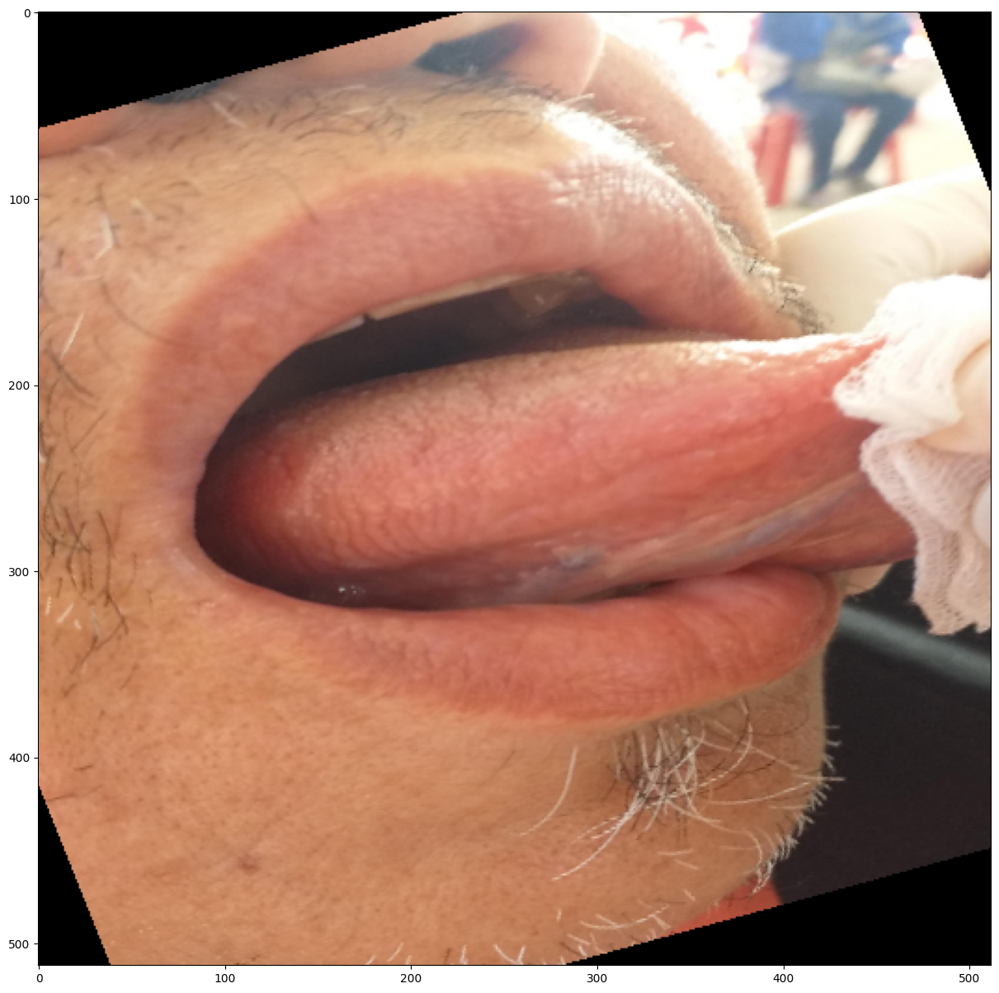

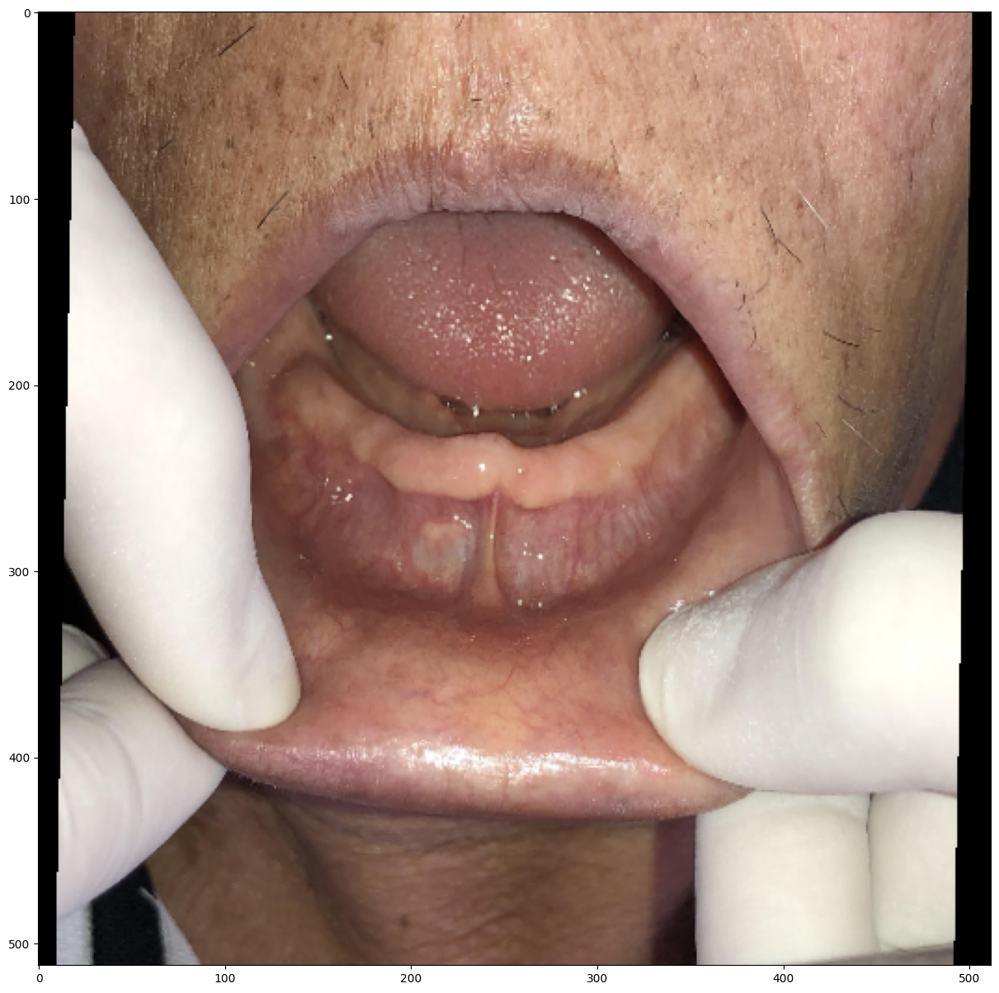

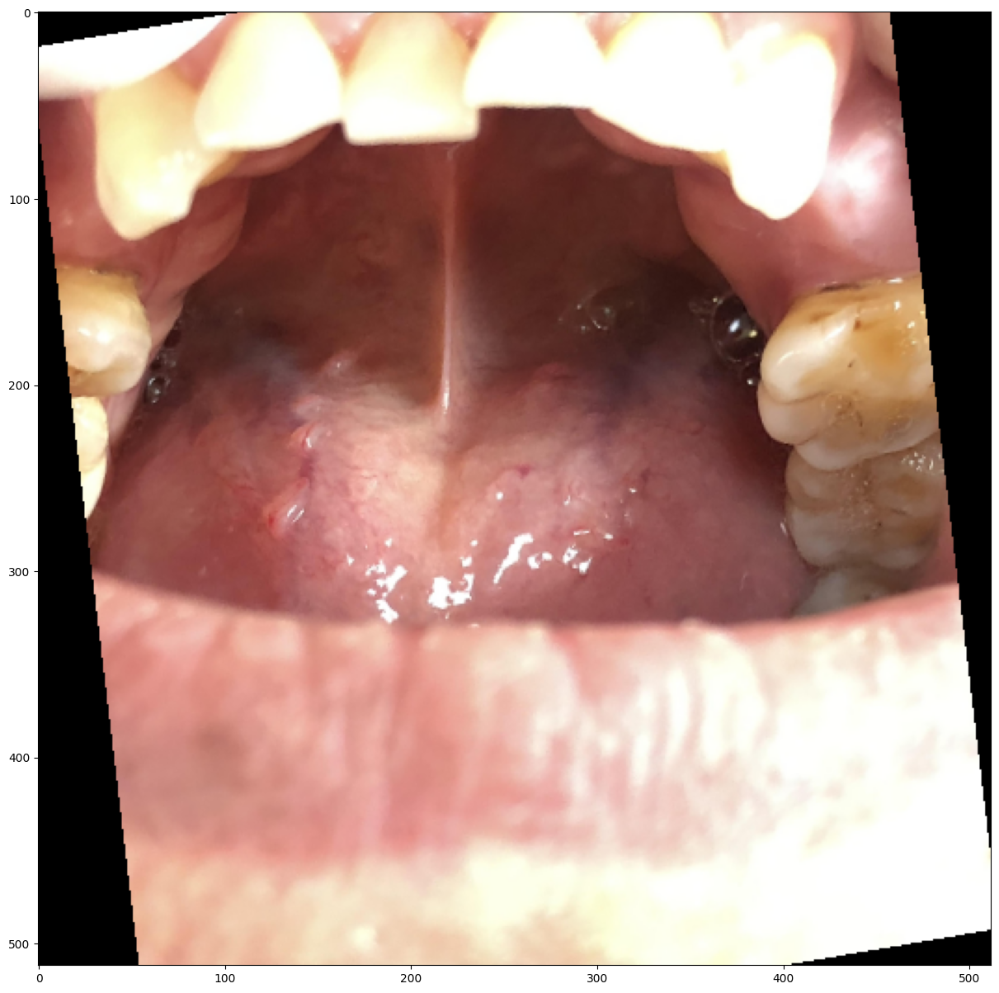

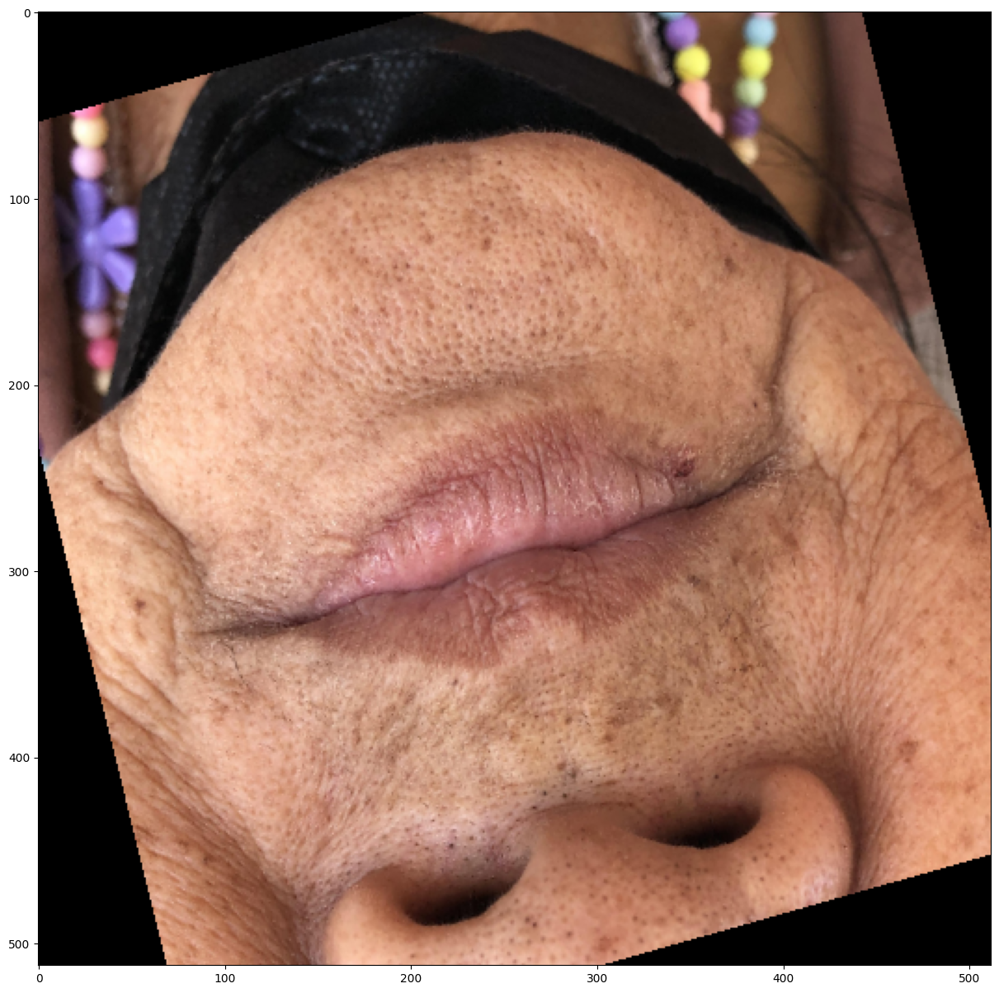

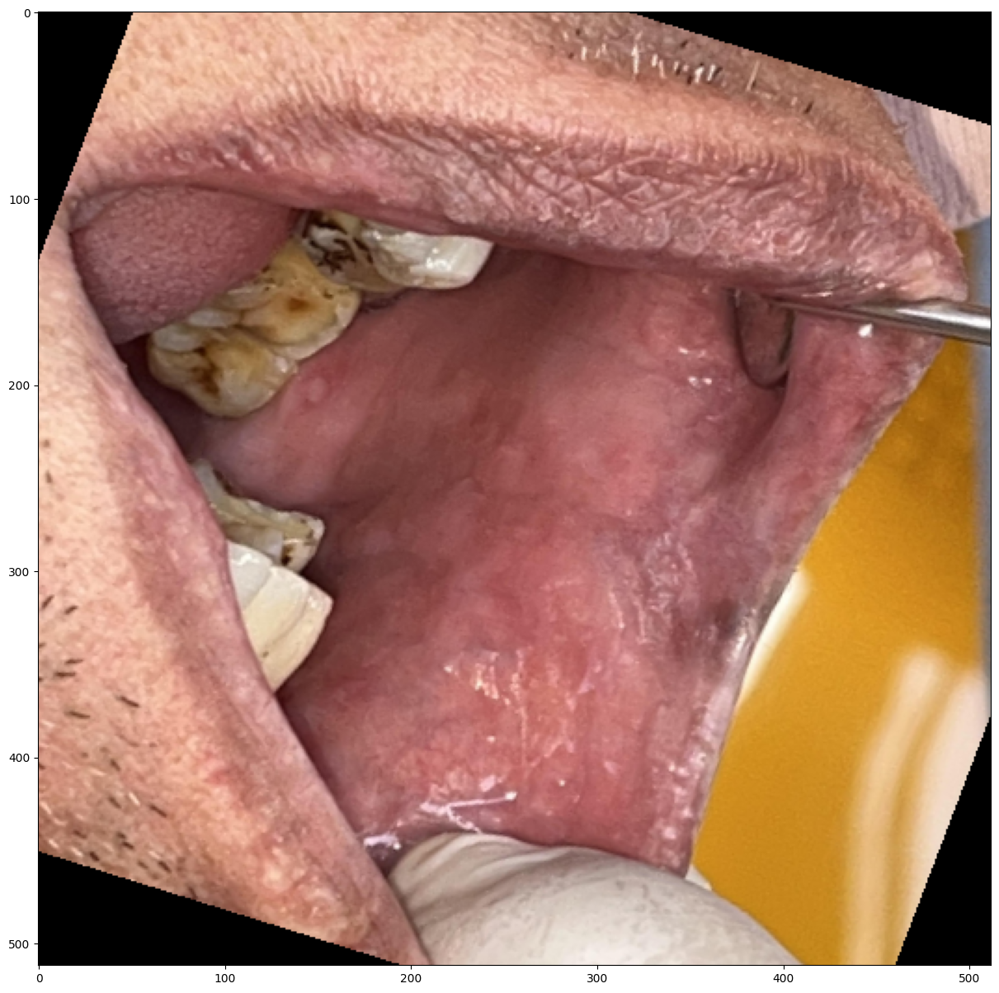

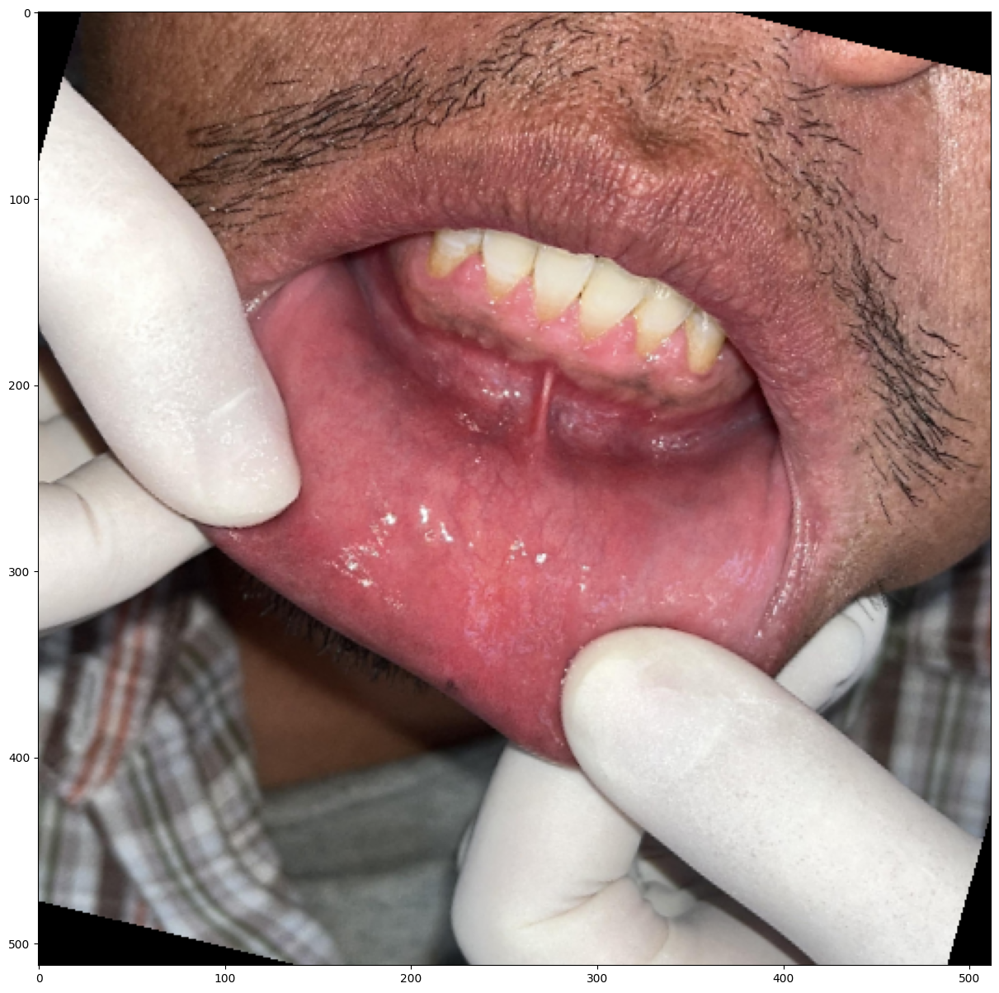

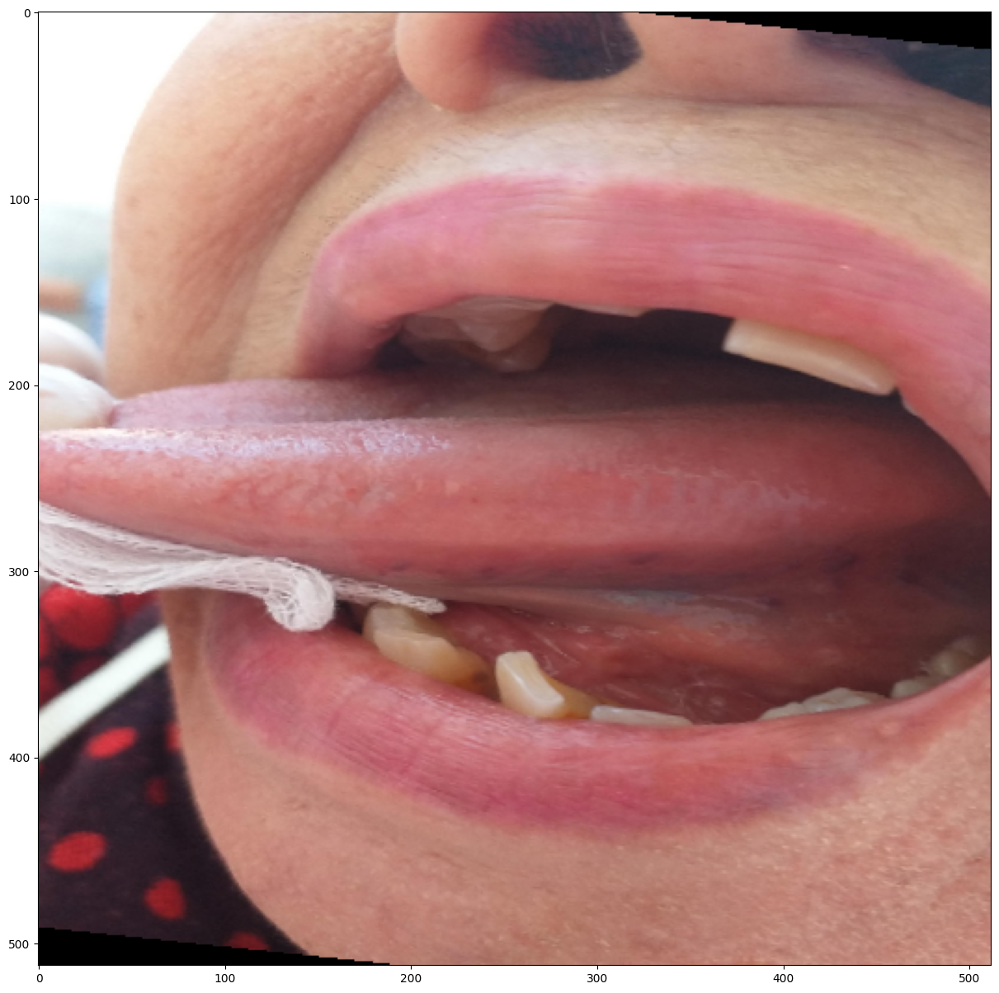

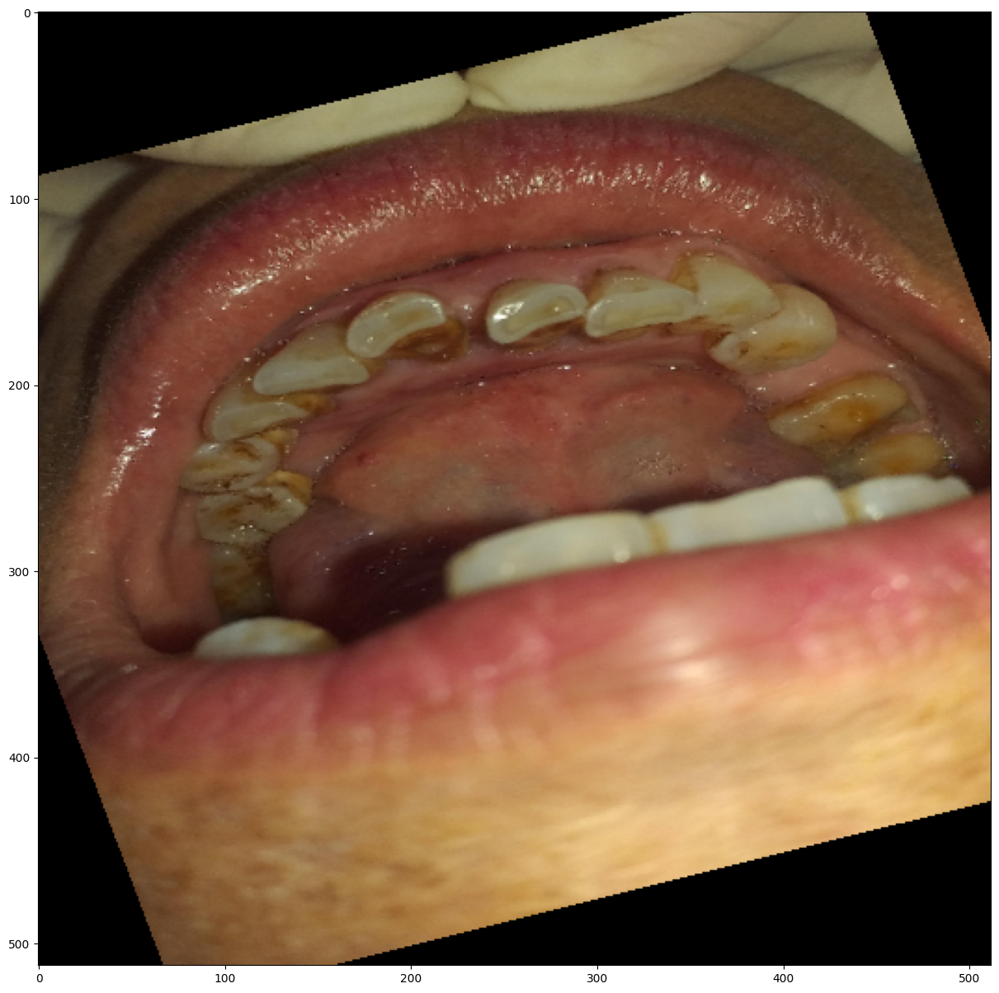

In [25]:
save_aug_path = "../Dataset/Images Augmentation/Oral Segmentation/"
for i in range(1):
    imgs = next(train_generator)[0]
    for k,j in enumerate(imgs):
        _,axs = plt.subplots(1,1,figsize=(15,15))
        axs.imshow(j)
#         cv2.imwrite(save_aug_path+"aug_"+str(i)+"_"+str(k)+".png",cv2.cvtColor(j*255, cv2.COLOR_RGB2BGR))

In [26]:
masks = next(train_generator)[1]

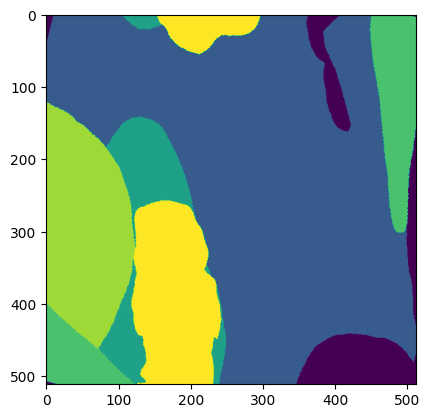

In [36]:
plt.imshow(np.argmax(masks[1],axis=-1))

In [ ]:
save_aug_path = "../Dataset/Images Augmentation/Oral Segmentation/"
for i in range(1):
    imgs = next(train_generator)[1]
    for k,j in enumerate(imgs):
        _,axs = plt.subplots(1,1,figsize=(15,15))
        axs.imshow(j)

In [27]:
# data["Augment"] = "brightness_range=(0.8, 1.2)"
data["Augment"] = '''
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='constant'
                '''

In [28]:
# aug_iter = image_datagen.flow(Xtrain, batch_size=1)
# fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))

# # generate batch of images
# for i in range(3):
#     # convert to unsigned integers
#     image = next(aug_iter)[0]
 
#     # plot image
#     ax[i].imshow(image)
#     ax[i].axis('off')

In [29]:
data

{'ModelName': 'segment_oral_multi_oragan_n_30',
 'ModelACTT': 'FPN',
 'BackBone': 'efficientnetb5',
 'Class': 8,
 'Epoch': 300,
 'BatchSize': 8,
 'Optimizer': 'Adam',
 'LearningRate': 0.001,
 'min_lr': 1e-05,
 'Beta1': 0.9,
 'Beta2': 0.999,
 'ImgSize': (512, 512),
 'EarlyStop': 50,
 'Detail': 'Model FPN efficientnetb5 ',
 'randomstate_splitdata': 804,
 'TrainSize': 663,
 'ValidSize': 98,
 'TestSize': 194,
 'Augment': "\n        rotation_range=20,\n        width_shift_range=0.2,\n        height_shift_range=0.2,\n        shear_range=0.2,\n        zoom_range=0.2,\n        horizontal_flip=True,\n        fill_mode='constant'\n                "}

In [19]:
from tensorflow.keras.optimizers import Adam 
from tensorflow.keras.callbacks import EarlyStopping ,ReduceLROnPlateau ,ModelCheckpoint ,TensorBoard
optimizer_adam=Adam(learning_rate=data["LearningRate"],beta_1=data["Beta1"],beta_2=data["Beta2"])

In [30]:
data['factor'] = 0.1
EarlyStop=EarlyStopping(patience=data["EarlyStop"],restore_best_weights=True,verbose=1) #when train and it can't get any better than this
Reduce_LR=ReduceLROnPlateau(monitor='loss',verbose=1,factor=data['factor'],patience=10,min_lr=data["min_lr"])
model_check=ModelCheckpoint(save_model_path+data["ModelName"]+'_best.h5',monitor='val_loss',verbose=1,save_best_only=True)
tensorbord=TensorBoard(log_dir='logs')


# EarlyStop,Reduce_LR = None,None

if Reduce_LR and EarlyStop:
    callback=[EarlyStop,Reduce_LR,model_check,tensorbord]
    data['Reduce_LR'] = 'True'
    data['Earlystop'] = 'True'
    print(1)
elif Reduce_LR:
    callback=[Reduce_LR,model_check,tensorbord]
    data['Reduce_LR'] = 'True'
    data['Earlystop'] = 'False'
    print(2)
elif EarlyStop:
    callback=[EarlyStop,model_check,tensorbord]
    data['Reduce_LR'] = 'False'
    data['Earlystop'] = 'True'
    print(3)
else:
    print(4)
    callback=[model_check,tensorbord]
# callback=[Reduce_LR,model_check,tensorbord]

1


In [31]:
ALPHA = 0.3
BETA = 0.7
data['loss_detail'] = "Tversky alpha=0.3 beta=0.7 gamma=2"
def TverskyLoss(targets, inputs, alpha=ALPHA, beta=BETA, smooth=1e-6):
        
        #flatten label and prediction tensors
        inputs = K.flatten(inputs)
        targets = K.flatten(targets)
        
        #True Positives, False Positives & False Negatives
        TP = K.sum((inputs * targets))
        FP = K.sum(((1-targets) * inputs))
        FN = K.sum((targets * (1-inputs)))
       
        Tversky = (TP + smooth) / (TP + alpha*FP + beta*FN + smooth)  
        
        return 1 - Tversky
    
#Keras
# ALPHA = 0.5
# BETA = 0.5
GAMMA = 2.0

def FocalTverskyLoss(targets, inputs, alpha=ALPHA, beta=BETA, gamma=GAMMA, smooth=1e-6):
    
        #flatten label and prediction tensors
        inputs = K.flatten(inputs)
        targets = K.flatten(targets)
        
        #True Positives, False Positives & False Negatives
        TP = K.sum((inputs * targets))
        FP = K.sum(((1-targets) * inputs))
        FN = K.sum((targets * (1-inputs)))
               
        Tversky = (TP + smooth) / (TP + alpha*FP + beta*FN + smooth)  
        FocalTversky = K.pow((1 - Tversky), gamma)
        
        return FocalTversky


In [32]:
# data['class_indexes'] = [0,1,1,1,1,1,1,1]

# model.compile(optimizer=optimizer_adam,loss="sparse_categorical_crossentropy",metrics=['accuracy'])

# sm.losses.categorical_focal_loss
# model.compile(optimizer=optimizer_adam,loss=sm.losses.categorical_focal_loss,metrics=["accuracy",sm.losses.categorical_focal_loss])
# data['Model_loss'] = 'sm.losses.categorical_focal_loss'

#focal jaccard loss
loss = sm.losses.categorical_focal_jaccard_loss
model.compile(optimizer=optimizer_adam,loss=loss,metrics=["accuracy",loss])
num_class = data['Class']
data['Model_loss'] = 'sm.losses.categorical_focal_jaccard_loss'
# data['Model_loss'] = 'sm.losses.categorical_focal_loss'
# data['Model_loss'] = 'sm.losses.categorical_focal_dice_loss'
# data['Model_loss'] = 'sm.losses.categorical_crossentropy' # 91
# data['Model_loss'] = 'sm.losses.jaccard_loss' # 92
# data['Model_loss'] = 'sm.losses.dice_loss'
# data['Model_loss'] = 'TverskyLoss'
# data['Model_loss'] = 'FocalTverskyLoss'
# model.compile(optimizer=optimizer_adam,loss=sm.losses.JaccardLoss(),metrics=["accuracy",sm.losses.JaccardLoss()])

#jaccard loss
# model.compile(optimizer=optimizer_adam,loss=sm.losses.JaccardLoss(class_indexes=data['class_indexes']),metrics=["accuracy",sm.losses.JaccardLoss(class_indexes=data['class_indexes'])])


In [33]:
with tf.device('/gpu'):
    history = model.fit(train_generator, 
                    epochs=data["Epoch"], # one forward/backward pass of training data
                    steps_per_epoch=Xtrain.shape[0]//data["BatchSize"], # number of images comprising of one epoch
                    validation_data=valid_generator, # data for validation
                    validation_steps=Xvalid.shape[0]//data["BatchSize"],
                    callbacks=callback, 
                    verbose=1,
                    workers=1,
                    use_multiprocessing=False         
                    )


/home/jupyter-g640631106/.local/lib/python3.8/site-packages/keras/preprocessing/image.py:680: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (663, 512, 512, 8) (8 channels).
  warnings.warn('NumpyArrayIterator is set to use the '


Epoch 1/300


2024-02-03 13:23:20.552930: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8700
2024-02-03 13:23:22.367379: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-02-03 13:23:22.368259: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-02-03 13:23:22.368276: W tensorflow/stream_executor/gpu/asm_compiler.cc:80] Couldn't get ptxas version string: INTERNAL: Couldn't invoke ptxas --version
2024-02-03 13:23:22.369057: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-02-03 13:23:22.369096: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] INTERNAL: Failed to launch ptxas
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.


82/82 [==============================] - ETA: 0s - loss: 0.6866 - accuracy: 0.6740 - focal_loss_plus_jaccard_loss: 0.6866

/home/jupyter-g640631106/.local/lib/python3.8/site-packages/keras/preprocessing/image.py:680: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (98, 512, 512, 8) (8 channels).
  warnings.warn('NumpyArrayIterator is set to use the '



Epoch 1: val_loss improved from inf to 0.65644, saving model to ../Oral_segment_result/segment_oral_multi_oragan_n_30/segment_oral_multi_oragan_n_30_best.h5
82/82 [==============================] - 242s 2s/step - loss: 0.6866 - accuracy: 0.6740 - focal_loss_plus_jaccard_loss: 0.6866 - val_loss: 0.6564 - val_accuracy: 0.8116 - val_focal_loss_plus_jaccard_loss: 0.6564 - lr: 1.0000e-04
Epoch 2/300
82/82 [==============================] - ETA: 0s - loss: 0.5077 - accuracy: 0.7829 - focal_loss_plus_jaccard_loss: 0.5077
Epoch 2: val_loss improved from 0.65644 to 0.49736, saving model to ../Oral_segment_result/segment_oral_multi_oragan_n_30/segment_oral_multi_oragan_n_30_best.h5
82/82 [==============================] - 220s 2s/step - loss: 0.5077 - accuracy: 0.7829 - focal_loss_plus_jaccard_loss: 0.5077 - val_loss: 0.4974 - val_accuracy: 0.8926 - val_focal_loss_plus_jaccard_loss: 0.4974 - lr: 1.0000e-04
Epoch 3/300
82/82 [==============================] - ETA: 0s - loss: 0.4536 - accuracy: 0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



82/82 [==============================] - ETA: 0s - loss: 0.2255 - accuracy: 0.8716 - focal_loss_plus_jaccard_loss: 0.2254
Epoch 112: val_loss did not improve from 0.24393
82/82 [==============================] - 195s 2s/step - loss: 0.2255 - accuracy: 0.8716 - focal_loss_plus_jaccard_loss: 0.2254 - val_loss: 0.2515 - val_accuracy: 0.9591 - val_focal_loss_plus_jaccard_loss: 0.2515 - lr: 1.0000e-05
Epoch 113/300
82/82 [==============================] - ETA: 0s - loss: 0.2265 - accuracy: 0.8780 - focal_loss_plus_jaccard_loss: 0.2264
Epoch 113: val_loss did not improve from 0.24393
82/82 [==============================] - 196s 2s/step - loss: 0.2265 - accuracy: 0.8780 - focal_loss_plus_jaccard_loss: 0.2264 - val_loss: 0.2632 - val_accuracy: 0.9596 - val_focal_loss_plus_jaccard_loss: 0.2632 - lr: 1.0000e-05
Epoch 114/300
82/82 [==============================] - ETA: 0s - loss: 0.2203 - accuracy: 0.8744 - focal_loss_plus_jaccard_loss: 0.2203
Epoch 114: val_loss did not improve from 0.24393
8

In [34]:
hist_df = pd.DataFrame(history.history) 
model.save(save_model_path+data["ModelName"]+".h5")
hist_df.to_csv(save_model_path+data["ModelName"]+".csv",index=False)

In [35]:
xtest = test_datagen.flow(Xtest, batch_size=len(Xtest),shuffle=False)
xtest = xtest[0]
# res = model.evaluate(xtest, Ytest, batch_size=len(Xtest))
# data["TrainAccuracy"] , data["TrainLoss"] = res[0],res[1] 
# print("loss,accuracy =",res)
# loss,accuracy = [0.21776536107063293, 0.9348815679550171] the first one


In [36]:
type(xtest[0][0][0][0])

numpy.float32

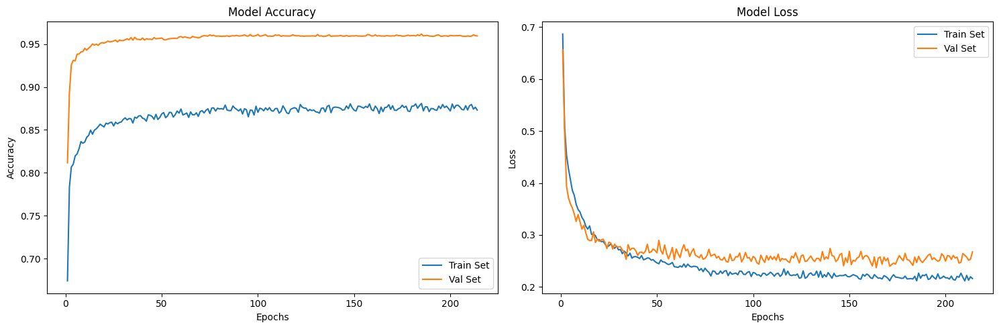

In [37]:
# Plot model performance
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs_range = range(1, len(history.epoch) + 1)

plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Train Set')
plt.plot(epochs_range, val_acc, label='Val Set')
plt.legend(loc="best")
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Model Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Train Set')
plt.plot(epochs_range, val_loss, label='Val Set')
plt.legend(loc="best")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Model Loss')

plt.tight_layout()
plt.savefig(save_model_path+data["ModelName"]+'.png')
plt.show()

In [49]:
# lr = history.history['lr']
# plt.xlabel('Epochs')
# plt.ylabel('Learning rate')
# plt.title('Model Learning rate Controller')
# plt.plot(lr)

In [39]:
#Add All images (sometime crash my program)
# y_pred=model.predict(xtest)
# y_pred=(y_pred > 0.3).astype(np.uint8)

In [40]:
#loop add my program
lst_y = []
with tf.device('/gpu:1'):
    for i in xtest:
        y_pred=model.predict(np.array([i]))
    #     y_pred=(y_pred > 0.3).astype(np.uint8) ## dont forget to remove
        lst_y.append(y_pred[0])
    y_pred = np.array(lst_y)

1/1 [==============================] - 0s 107ms/step


In [41]:
#One hot to number
with tf.device('/gpu:1'):
    y_pred_num = np.argmax(y_pred, axis=3, out=None)
    y_test_num = np.argmax(Ytest, axis=3, out=None)

x_test = Xtest.astype(int)

In [42]:
# print(y_test.shape,y_pred.shape)
print(y_test_num.shape,y_pred_num.shape)

(194, 512, 512) (194, 512, 512)


In [43]:
#New test
class_names = ["Background", "Another inside", "Buccal Mucosa", "Floor of Mouth", "Gums", "Lips", "Tongue", "Tooth"]  # Replace with your class names

cm = mt.confusion_matrix_opm(y_test_num.flatten(),y_pred_num.flatten(),num_classes=8)
print(cm)

jc_ec,jc_macro,jc_weighted = mt.jaccard_scores_opm(y_test_num.flatten(),y_pred_num.flatten(),num_classes=8,average="all",class_names=class_names)
print(jc_ec,jc_weighted)

f1 = mt.f1_score_opm(y_test_num.flatten(),y_pred_num.flatten(),num_classes=8,average="all",class_names=class_names)


data['jaccard_score'] = jc_ec
data['jaccard_score_macro'] = jc_macro
data['jaccard_score_weighted'] = jc_weighted

data['f1-score'] = f1['f1_scores']
data['f1-score-macro'] = f1['macro_f1']
data['weighted_precisions']= f1['weighted_precisions']
data['weighted_recalls'] = f1['weighted_recalls']
data['f1-score-weighted'] = f1['weighted_average_f1_scores']

[[32184464     2134    32040      132      741   277232     4822     2836]
 [    6708    58277    17701      837     2201     3953    15409     6232]
 [   18906    15611  5009513    10449   141526   170998    15773    10913]
 [    4185      759    21781   204163    18852     5585    37285     1995]
 [    5098     8354   207954     9806  1507686     9713     8515    29700]
 [  334476     2251   229128      447     5867  5499361     9767    10298]
 [    2411    10803    22725    21222     8127    11272  2192869     9835]
 [    3104     8108    17940      574    29063     7874     4206  2323369]]
Jaccard Scores for Each Class: [0.9788673958247698, 0.3657445179429891, 0.8429325934997354, 0.6039039021273575, 0.7564136718638292, 0.8359950454697334, 0.9232973241304044, 0.9421430329592259]
----------------------------------------------------------------------------------------------------
Background: Jaccard Score = 0.9788673958247698, Weight = 32504401
Another inside: Jaccard Score = 0.365744

In [44]:
#Old test
# with tf.device('/gpu:1'):
#     data['jaccard_score'] = jaccard_score(y_test_num.flatten(),y_pred_num.flatten(),average=None)
#     print(data['jaccard_score'])
#     data['jaccard_score_macro'] = jaccard_score(y_test_num.flatten(),y_pred_num.flatten(),average='macro')
#     print(data['jaccard_score_macro'])
#     data['jaccard_score_micro'] = jaccard_score(y_test_num.flatten(),y_pred_num.flatten(),average='micro')
#     print(data['jaccard_score_micro'])
#     data['jaccard_score_weighted'] = jaccard_score(y_test_num.flatten(),y_pred_num.flatten(),average='weighted')
#     print(data['jaccard_score_weighted'])

In [45]:
with tf.device('/gpu:1'):
    cf = confusion_matrix(y_test_num.flatten(), y_pred_num.flatten())
    data['cf'] = cf
    print(cf)

[[32184464     2134    32040      132      741   277232     4822     2836]
 [    6708    58277    17701      837     2201     3953    15409     6232]
 [   18906    15611  5009513    10449   141526   170998    15773    10913]
 [    4185      759    21781   204163    18852     5585    37285     1995]
 [    5098     8354   207954     9806  1507686     9713     8515    29700]
 [  334476     2251   229128      447     5867  5499361     9767    10298]
 [    2411    10803    22725    21222     8127    11272  2192869     9835]
 [    3104     8108    17940      574    29063     7874     4206  2323369]]


In [46]:
lst_cls = ["Background","Another Inside","Bucca Mucosa","Floor of Mouth","Gums","Lips","Tongue","Tooth"]

In [47]:
df_cm = pd.DataFrame(cf, index = [i for i in lst_cls], columns = [i for i in lst_cls])
plt.figure(figsize = (10,7))
sn.heatmap(df_cm, annot=True)
plt.savefig(save_model_path+"/"+"confuse_matrix.png")
plt.close()

In [48]:
# with tf.device('/gpu:1'):
#     data['f1-score-macro'] = f1_score(y_test_num.flatten(),y_pred_num.flatten(),average='macro')
#     data['f1-score-micro'] = f1_score(y_test_num.flatten(),y_pred_num.flatten(),average='micro')
#     data['f1-score-weighted'] = f1_score(y_test_num.flatten(),y_pred_num.flatten(),average='weighted')
#     print("macro:",data['f1-score-macro'],"micro:",data['f1-score-micro'],"weight:",data['f1-score-weighted'])

In [50]:
def dice_coef(y_true, y_pred, smooth=1):
    # flatten
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    # one-hot encoding y with 3 labels : 0=background, 1=label1, 2=label2
    y_true_f = K.one_hot(K.cast(y_true_f, np.uint8), 3)
    y_pred_f = K.one_hot(K.cast(y_pred_f, np.uint8), 3)
    # calculate intersection and union exluding background using y[:,1:]
    intersection = K.sum(y_true_f[:,1:]* y_pred_f[:,1:], axis=[-1])
    union = K.sum(y_true_f[:,1:], axis=[-1]) + K.sum(y_pred_f[:,1:], axis=[-1])
    # apply dice formula
    dice = K.mean((2. * intersection + smooth)/(union + smooth), axis=0)
    return dice

def dice_loss(y_true, y_pred):
    return 1-dice_coef(y_true, y_pred)

In [51]:
with tf.device('/gpu:1'):
    data["dicescore"] = dice_coef(y_test_num.flatten(),y_pred_num.flatten()).numpy()

In [52]:
from matplotlib import cm
def map_label2image(img,label,tresh=128):
    '''
    image type as numpy array (data range'0-255' or '0-1')
    label type as numpy array (data uint8 expect class of pixel)
    tresh range of mask transparent (type int '0-255')
    '''
    
    if np.max(img) <= 1.0:
        img = img*255.0
    imp = Image.fromarray(img.astype(np.uint8))
    t = Image.fromarray(np.uint8(cm.tab20(label)*255)) #tab10
    mask = np.where(label>0,tresh,0)
    mask = Image.fromarray(mask.astype(np.uint8))
#     return np.array(imp.paste(t,(0, 0),mask=mask))
    imp.paste(t,(0, 0),mask=mask)
    return np.array(imp)

In [53]:
img_path2 = "/images_res2"
if os.path.isdir(save_model_path+img_path2) == False:
    os.mkdir(save_model_path+img_path2)

In [54]:
with tf.device('/gpu:1'):
    for i in range(len(Xtest)):
        fig, axs = plt.subplots(1,4,figsize=(15,15))
        axs[0].imshow(Xtest[i].astype(np.uint8))
        axs[0].title.set_text("image : "+str(i))
        axs[0].axis('off')
        axs[1].imshow(y_pred_num[i])
        axs[1].title.set_text("predict")
        axs[1].axis('off')
        axs[2].imshow(y_test_num[i])
        axs[2].title.set_text("ground truth")
        axs[2].axis('off')
        axs[3].imshow(map_label2image(Xtest[i],y_pred_num[i]))
        axs[3].title.set_text("map")
        axs[3].axis('off')
        fig.tight_layout()
        plt.savefig(save_model_path+img_path2+"/"+Xtest_n[i].split("/")[-1])
        plt.close()

In [55]:
img_path = "/images_res"
if os.path.isdir(save_model_path+img_path) == False:
    os.mkdir(save_model_path+img_path)

In [ ]:
with tf.device('/gpu:1'):
    for i in range(len(Xtest)):
        fig, axs = plt.subplots(1,1,figsize=(15,15))
        axs.imshow(map_label2image(Xtest[i],y_pred_num[i]))
        axs.title.set_text("ground truth")
        axs.axis('off')
        plt.close()
        cv2.imwrite(save_model_path+img_path+"/"+Xtest_n[i].split("/")[-1],cv2.cvtColor(map_label2image(Xtest[i],y_pred_num[i]), cv2.COLOR_RGB2BGR))

In [ ]:
mask_path = "/pred_mask"
if os.path.isdir(save_model_path+mask_path) == False:
    os.mkdir(save_model_path+mask_path)

In [ ]:
with tf.device('/gpu:1'):
    for i in range(len(y_pred_num)):
        cv2.imwrite(save_model_path+mask_path+"/"+Xtest_n[i].split("/")[-1],y_pred_num[i])

In [ ]:
data

In [ ]:
ml.dict_2_txt(data,save_model_path+"data.txt") # save data detail